# Investigate wrong predictions
This Notebook is used to analyse wrong predictions. A model is loaded then the confusion matrix is calculated with the models predictions. The confusion matrix is used to determine which classes and the wrong predictions for that class should will be checked. 

Then wrong predictions are plotted and saved as images.

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import os
import tensorflow as tf
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.metrics import confusion_matrix
import matplotlib.gridspec as gridspec

In [2]:
# Use CPU instead of GPU (because of OOM issues)
os.environ["CUDA_VISIBLE_DEVICES"]="-1" 
my_devices = tf.config.experimental.list_physical_devices(device_type='CPU')

# Load and Predict

## Load
Model and Data

In [3]:
# path to save result images to
save_img_path = r"C:\Users\Christian\PycharmProjects\InnovationsProjektWebScraper\resultdata\Checking_Bad_Predictions"
save_img_path = os.path.join(save_img_path)  # convert to os path object

# path to saved models from the project
PATH = "C:/Users/Christian/PycharmProjects/InnovationsProjektWebScraper/resultdata"  # for loading model

In [4]:
# data path and settings
data_dir = "C:/Users/Christian/PycharmProjects/_data/InnovationsProjekt_TEST_SET" # path to test set
IMG_SIZE = (224, 224)
BATCH_SIZE = 16

In [5]:
# load dataset as whole (when using CPU it works)
test_set = tf.keras.utils.image_dataset_from_directory(
    data_dir,
    seed=123,
    image_size=IMG_SIZE,
    batch_size=BATCH_SIZE)

normalization_layer = tf.keras.layers.Rescaling(1. / 255)
test_set = test_set.map(lambda x, y: (normalization_layer(x), y))

AUTOTUNE = tf.data.AUTOTUNE
test_set_1 = test_set.prefetch(buffer_size=AUTOTUNE)

Found 27801 files belonging to 65 classes.


In [6]:
# path to a specific saved model
SAVE_FOLDER = "v7_AbetterSplit_ResNet50v2_1_augmented_BEST"+"/modelsaves"
PATH_TO_LOAD = os.path.join(PATH, SAVE_FOLDER)

MODEL_NAME_KERAS = "myModel_fineTuned"
PATH_TO_LOAD_FINAL = os.path.join(PATH_TO_LOAD, MODEL_NAME_KERAS)

In [7]:
# class names taken from the dataset
CLASS_NAMES = ['A205', 'A207', 'A208', 'A209', 'A217', 'A238', 'C117', 'C118', 'C167', 'C204', 'C205', 'C207', 'C208',
                'C209', 'C215', 'C216', 'C217', 'C218', 'C219', 'C238', 'C253', 'C257', 'C292', 'CL203', 'H247', 'N293',
                'S202', 'S203', 'S204', 'S205', 'S210', 'S211', 'S212', 'S213', 'T245', 'T246', 'V167', 'W163', 'W164',
                'W166', 'W202', 'W203', 'W204', 'W205', 'W210', 'W211', 'W212', 'W213', 'W247', 'W461-463', 'WV140',
                'WV220', 'WV221', 'WV222', 'WV223', 'X117', 'X118', 'X156', 'X164', 'X166', 'X167', 'X204', 'X218',
                'X247', 'X253']

In [8]:
#load model
print(f"Loading from here: {PATH_TO_LOAD_FINAL}")
model = tf.keras.models.load_model(PATH_TO_LOAD_FINAL)

Loading from here: C:/Users/Christian/PycharmProjects/InnovationsProjektWebScraper/resultdata\v7_AbetterSplit_ResNet50v2_1_augmented_BEST/modelsaves\myModel_fineTuned


In [9]:
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 resnet50v2 (Functional)     (None, 7, 7, 2048)        23564800  
                                                                 
 global_average_pooling2d (G  (None, 2048)             0         
 lobalAveragePooling2D)                                          
                                                                 
 dropout (Dropout)           (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 65)                133185    
                                                                 
Total params: 23,697,985
Trainable params: 15,367,233
Non-trainable params: 8,330,752
_________________________________________

In [10]:
# evaluate model again

print("Evaluate")
result = model.evaluate(test_set)
eval_results = dict(zip(_model.metrics_names, result))
print(eval_results)

## Predict with the model
Prediction of the model over the whole test_set.

In [11]:
target_array = np.array([])
prediction_array = np.array([])

# iterates batch wise over validation dataset
for images, targets in test_set:
    # y = model(image, training=False)  # Or y = model.predict(image)
    y = model.predict(images)

    # turn logits into normalized prediction
    y = tf.nn.softmax(y)  # shape is (32, 65) 32 rows with 65 columns each column is one class

    # Get predicted label (max value index of each of the 32 rows)
    y = np.argmax(y, axis=1)

    targets = targets.numpy()
    # print(target.shape)  # 32 , liste mit 32 einträgen

    target_array = np.concatenate((target_array, targets))
    prediction_array = np.concatenate((prediction_array, y))

target_array = target_array.astype(int)
prediction_array = prediction_array.astype(int)

### Create cunfusion matrix

In [12]:
cm = confusion_matrix(y_true=target_array, y_pred=prediction_array)
print(cm.shape)
print(len(cm))

(65, 65)
65


In [13]:
print(cm)

[[490   0   0 ...   0   0   0]
 [  1 162   0 ...   0   0   0]
 [  0   0 234 ...   0   0   0]
 ...
 [  0   0   0 ... 141   0   0]
 [  0   0   0 ...   0 279   4]
 [  0   0   0 ...   0  14 632]]


# Analyse wrong predictions
In order to understand why the model predicts wrong, the wronly predicted data is looked at. <br/>
First for each class the two most commonly wrong predictions are determined and an accuarcy per class is calculated. This is done by looking at the confusion matrix and each entry for each row (class).

In [14]:
# get accuracy for each class
# aslo get the 2 most often wrongly predicted classes for each class (as value and class name)

accuracy_per_class = {}
images_per_class = {}
##highest_false_prediction_indecies = {}
highest_false_prediction_values = {}
highest_false_prediction_classes = {}

for row in range(len(cm)):
    correct = 0
    errorsum = 0
    for column in range(len(cm)):
        if column == row:
            correct = cm[row][column]
        else:
            errorsum += cm[row][column]
    accuracy = correct/(correct+errorsum)
    #print(f"Class {CLASS_NAMES[row]} has acc: {round(accuracy, 3)}")
    
    accuracy_per_class[CLASS_NAMES[row]] = (round(accuracy, 4))
    images_per_class[CLASS_NAMES[row]] = sum(cm[row])
    
    current_row_list = cm[row]
    max_indecies = current_row_list.argsort()[-3:][::-1]
    
    # what is the biggest issue per class? where do the false predictions come from. Check top 2 false predictions
    # ignore highest value which is the correct prediciton for every row
    ##highest_false_prediction_indecies[CLASS_NAMES[row]] = max_indecies[1:]
    highest_false_prediction_values[CLASS_NAMES[row]] = [ cm[row][max_indecies[1:][0]], cm[row][max_indecies[1:][1]] ]
    highest_false_prediction_classes[CLASS_NAMES[row]] =  [CLASS_NAMES[max_indecies[1:][0]], CLASS_NAMES[max_indecies[1:][1]]]

In [15]:
print(accuracy_per_class)

{'A205': 0.9007, 'A207': 0.8438, 'A208': 0.8699, 'A209': 0.8615, 'A217': 0.7229, 'A238': 0.9238, 'C117': 0.542, 'C118': 0.7235, 'C167': 0.87, 'C204': 0.7639, 'C205': 0.8379, 'C207': 0.8242, 'C208': 0.7419, 'C209': 0.5459, 'C215': 0.8643, 'C216': 0.8385, 'C217': 0.7342, 'C218': 0.8197, 'C219': 0.9247, 'C238': 0.6102, 'C253': 0.7241, 'C257': 0.8717, 'C292': 0.9245, 'CL203': 0.8976, 'H247': 0.8734, 'N293': 0.9513, 'S202': 0.7708, 'S203': 0.8819, 'S204': 0.9236, 'S205': 0.8833, 'S210': 0.8963, 'S211': 0.8492, 'S212': 0.9152, 'S213': 0.8722, 'T245': 0.9624, 'T246': 0.962, 'V167': 0.8197, 'W163': 0.9726, 'W164': 0.9107, 'W166': 0.6927, 'W202': 0.8798, 'W203': 0.8924, 'W204': 0.8627, 'W205': 0.7714, 'W210': 0.7826, 'W211': 0.8282, 'W212': 0.8426, 'W213': 0.7465, 'W247': 0.929, 'W461-463': 0.9891, 'WV140': 0.8345, 'WV220': 0.8458, 'WV221': 0.9202, 'WV222': 0.8482, 'WV223': 0.8301, 'X117': 0.8876, 'X118': 0.9039, 'X156': 0.837, 'X164': 0.9826, 'X166': 0.7969, 'X167': 0.9517, 'X204': 0.9575, 'X2

In [16]:
print(highest_false_prediction_values)

{'A205': [14, 14], 'A207': [12, 4], 'A208': [12, 12], 'A209': [19, 8], 'A217': [11, 9], 'A238': [10, 4], 'C117': [22, 4], 'C118': [27, 6], 'C167': [17, 3], 'C204': [24, 8], 'C205': [31, 11], 'C207': [25, 8], 'C208': [18, 9], 'C209': [34, 13], 'C215': [8, 4], 'C216': [11, 7], 'C217': [16, 12], 'C218': [30, 5], 'C219': [7, 7], 'C238': [64, 9], 'C253': [27, 9], 'C257': [7, 3], 'C292': [9, 4], 'CL203': [17, 5], 'H247': [5, 3], 'N293': [3, 3], 'S202': [11, 6], 'S203': [21, 6], 'S204': [60, 6], 'S205': [48, 22], 'S210': [8, 2], 'S211': [15, 10], 'S212': [29, 13], 'S213': [45, 30], 'T245': [18, 3], 'T246': [5, 4], 'V167': [28, 8], 'W163': [3, 1], 'W164': [9, 8], 'W166': [32, 4], 'W202': [10, 8], 'W203': [45, 11], 'W204': [88, 25], 'W205': [116, 29], 'W210': [18, 16], 'W211': [32, 26], 'W212': [51, 12], 'W213': [105, 35], 'W247': [12, 5], 'W461-463': [7, 0], 'WV140': [8, 6], 'WV220': [13, 4], 'WV221': [6, 4], 'WV222': [12, 6], 'WV223': [13, 6], 'X117': [14, 6], 'X118': [38, 3], 'X156': [10, 4]

In [17]:
print(highest_false_prediction_classes)

{'A205': ['C205', 'S205'], 'A207': ['C207', 'A238'], 'A208': ['A209', 'C208'], 'A209': ['A208', 'C209'], 'A217': ['A205', 'A238'], 'A238': ['A205', 'C238'], 'C117': ['X117', 'A205'], 'C118': ['X118', 'C257'], 'C167': ['V167', 'C292'], 'C204': ['W204', 'S204'], 'C205': ['A205', 'S205'], 'C207': ['W212', 'A207'], 'C208': ['A208', 'W211'], 'C209': ['A209', 'A208'], 'C215': ['CL203', 'W203'], 'C216': ['C218', 'W204'], 'C217': ['A217', 'A238'], 'C218': ['X218', 'A238'], 'C219': ['C218', 'A209'], 'C238': ['A238', 'C205'], 'C253': ['X253', 'C292'], 'C257': ['C118', 'C205'], 'C292': ['W166', 'X253'], 'CL203': ['W203', 'A209'], 'H247': ['X156', 'X247'], 'N293': ['X253', 'A238'], 'S202': ['W202', 'S210'], 'S203': ['W203', 'S204'], 'S204': ['W204', 'S212'], 'S205': ['W205', 'A205'], 'S210': ['W210', 'S203'], 'S211': ['W211', 'S203'], 'S212': ['W212', 'S204'], 'S213': ['W213', 'S205'], 'T245': ['T246', 'S212'], 'T246': ['S205', 'S212'], 'V167': ['C167', 'X167'], 'W163': ['S204', 'S203'], 'W164': [

In [18]:
print(images_per_class)

{'A205': 544, 'A207': 192, 'A208': 269, 'A209': 296, 'A217': 83, 'A238': 407, 'C117': 131, 'C118': 170, 'C167': 200, 'C204': 216, 'C205': 475, 'C207': 421, 'C208': 155, 'C209': 218, 'C215': 221, 'C216': 322, 'C217': 222, 'C218': 366, 'C219': 372, 'C238': 254, 'C253': 174, 'C257': 187, 'C292': 265, 'CL203': 410, 'H247': 158, 'N293': 411, 'S202': 96, 'S203': 381, 'S204': 1427, 'S205': 1568, 'S210': 135, 'S211': 325, 'S212': 884, 'S213': 1119, 'T245': 1063, 'T246': 736, 'V167': 305, 'W163': 146, 'W164': 336, 'W166': 179, 'W202': 233, 'W203': 818, 'W204': 1318, 'W205': 1015, 'W210': 299, 'W211': 786, 'W212': 921, 'W213': 868, 'W247': 549, 'W461-463': 643, 'WV140': 139, 'WV220': 201, 'WV221': 451, 'WV222': 336, 'WV223': 153, 'X117': 338, 'X118': 614, 'X156': 227, 'X164': 115, 'X166': 128, 'X167': 145, 'X204': 447, 'X218': 194, 'X247': 290, 'X253': 734}


### Plot accuracy per class

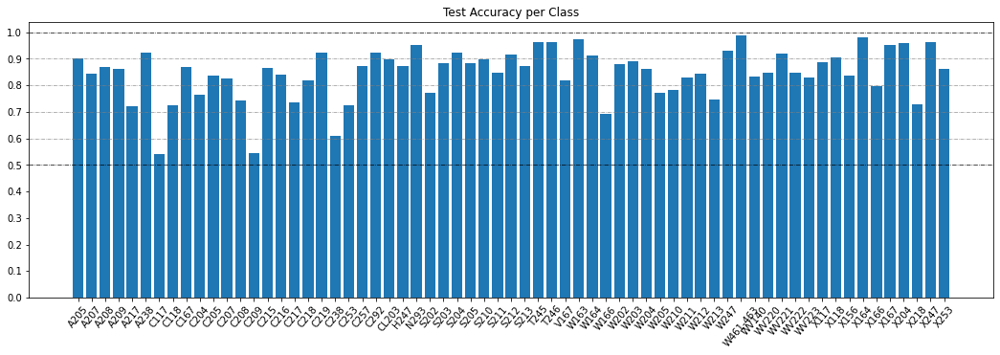

In [19]:
fig = plt.figure(figsize=(7, 4))
ax = fig.add_axes([0, 0, 2, 1])
ax.bar(CLASS_NAMES, accuracy_per_class.values())
plt.xticks(rotation=50)
plt.yticks(np.arange(0.0, 1.1, 0.1))
plt.title("Test Accuracy per Class")
plt.axhline(y=0.5, color='black', linestyle='-.', lw=0.7)
plt.axhline(y=1.0, color='black', linestyle='-.', lw=0.7)
plt.axhline(y=0.6, color='grey', linestyle='-.', lw=0.6)
plt.axhline(y=0.7, color='grey', linestyle='-.', lw=0.6)
plt.axhline(y=0.8, color='grey', linestyle='-.', lw=0.6)
plt.axhline(y=0.9, color='grey', linestyle='-.', lw=0.6)
#plt.savefig(os.path.join(save_img_path, 'accuracyPerClass.png'), bbox_inches="tight")
plt.show()

### Get biggest error relative to class size
In order to narrow the examination down to the most important issues, the ratio between each class and its most common false prediction is calculated. If the ratio is equal or greater than 10% then, for this specific combination of class and wrong prediction (this entry in the confusion matrix), the images are plotted to be looked at. 

In [20]:
# Check the error ratio of the most often wrongly predicted class label 
# i.e. from all wrong predictions of class A205, most are wrongly predicted as C205. But its only a ratio of 0.0257

classes_to_have_closer_look = []

for c in CLASS_NAMES:
    
    highest_false_prediction = highest_false_prediction_values[c][0]
    images_count = images_per_class[c]
    
    error_ratio = highest_false_prediction / images_count # Fehler / alle
    if error_ratio >= 0.1:
        classes_to_have_closer_look.append(c)
        print(f"{c} : {error_ratio}")
        
print(len(classes_to_have_closer_look))
print(classes_to_have_closer_look)

A217 : 0.13253012048192772
C117 : 0.16793893129770993
C118 : 0.1588235294117647
C204 : 0.1111111111111111
C208 : 0.11612903225806452
C209 : 0.1559633027522936
C238 : 0.25196850393700787
C253 : 0.15517241379310345
S202 : 0.11458333333333333
W166 : 0.1787709497206704
W205 : 0.11428571428571428
W213 : 0.12096774193548387
X218 : 0.21649484536082475
13
['A217', 'C117', 'C118', 'C204', 'C208', 'C209', 'C238', 'C253', 'S202', 'W166', 'W205', 'W213', 'X218']


In [21]:
# Taken from output, saved for faster access (without calculating it again)
classes_to_have_closer_look = ['A217', 'C117', 'C118', 'C204', 'C208', 'C209', 'C238',
                               'C253', 'S202', 'W166', 'W205', 'W213', 'X218']
highest_false_prediction_classes = {'A205': ['C205', 'S205'], 'A207': ['C207', 'A238'], 'A208': ['A209', 'C208'],
                                    'A209': ['A208', 'C209'],
    'A217': ['A205', 'A238'], 'A238': ['A205', 'C238'], 'C117': ['X117', 'A205'], 'C118': ['X118', 'C257'],
    'C167': ['V167', 'C292'], 'C204': ['W204', 'S204'], 'C205': ['A205', 'S205'], 'C207': ['W212', 'A207'],
    'C208': ['A208', 'W211'], 'C209': ['A209', 'A208'], 'C215': ['CL203', 'W203'], 'C216': ['C218', 'W204'],
    'C217': ['A217', 'A238'], 'C218': ['X218', 'A238'], 'C219': ['C218', 'A209'], 'C238': ['A238', 'C205'],
    'C253': ['X253', 'C292'], 'C257': ['C118', 'C205'], 'C292': ['W166', 'X253'], 'CL203': ['W203', 'A209'],
    'H247': ['X156', 'X247'], 'N293': ['X253', 'A238'], 'S202': ['W202', 'S210'], 'S203': ['W203', 'S204'],
    'S204': ['W204', 'S212'], 'S205': ['W205', 'A205'], 'S210': ['W210', 'S203'], 'S211': ['W211', 'S203'],
    'S212': ['W212', 'S204'], 'S213': ['W213', 'S205'], 'T245': ['T246', 'S212'], 'T246': ['S205', 'S212'],
    'V167': ['C167', 'X167'], 'W163': ['S204', 'S203'], 'W164': ['X204', 'X164'], 'W166': ['C292', 'X253'],
    'W202': ['S202', 'WV140'], 'W203': ['S203', 'WV220'], 'W204': ['S204', 'C204'], 'W205': ['S205', 'C205'],
    'W210': ['WV140', 'S210'], 'W211': ['W203', 'S211'], 'W212': ['S212', 'W204'], 'W213': ['S213', 'A238'],
    'W247': ['X118', 'C257'], 'W461-463': ['X204', 'X253'], 'WV140': ['W202', 'WV220'], 'WV220': ['W203', 'WV140'],
    'WV221': ['C216', 'WV222'], 'WV222': ['W205', 'C218'], 'WV223': ['WV222', 'W213'], 'X117': ['C117', 'S205'],
    'X118': ['C118', 'X117'], 'X156': ['H247', 'X247'], 'X164': ['X204', 'W461-463'], 'X166': ['W166', 'X167'],
    'X167': ['X253', 'X247'], 'X204': ['S204', 'T246'], 'X218': ['C218', 'X117'], 'X247': ['X253', 'X167'],
    'X253': ['C253', 'X247']}

## Save Images of biggest Issues
For each entry in the confusion matrix (pair of class and wrongly predicted class) that should be investigated: <br/>
- Get the wrongly predicted images and save them in one image
- Get some examples from each class to visually compare them in generell (What are the visual differences?)

The images are then saved to be looked at later. <br/>
For the images that just compares to car types, the first two columns are type 1 and the last two columns are type 2.

 target A217 predicted as A205 
get wrong images
show wrong images
11


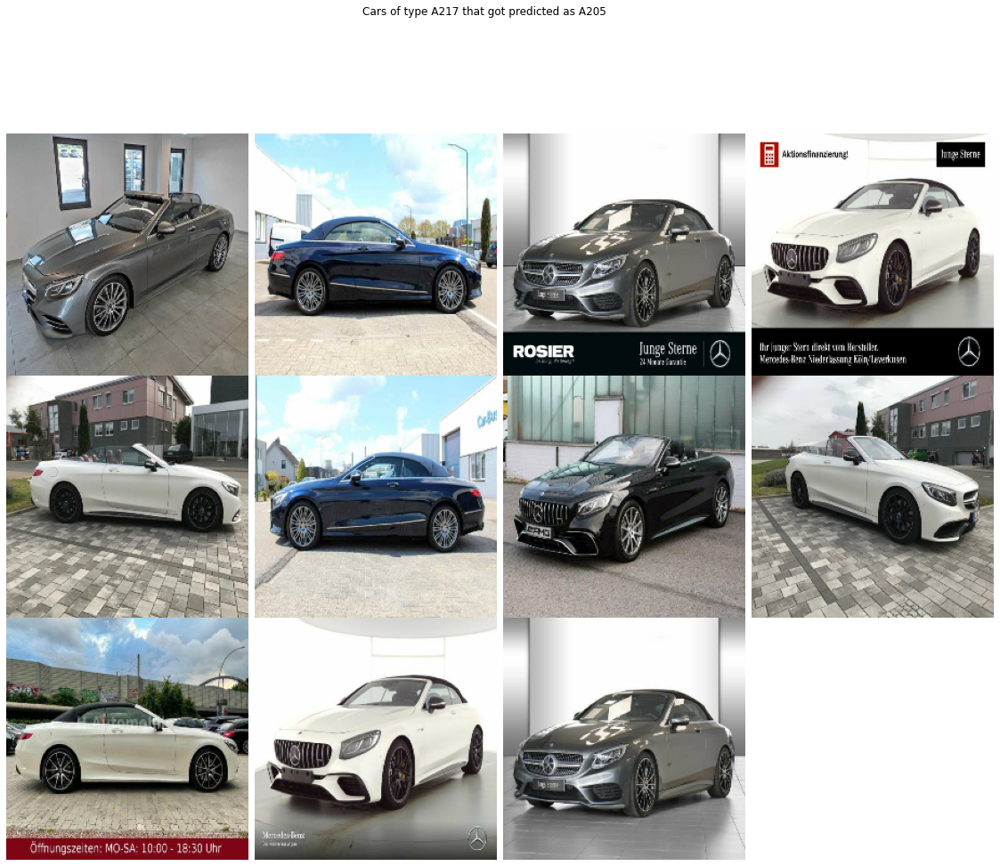

get examples to compare
show examples to compare


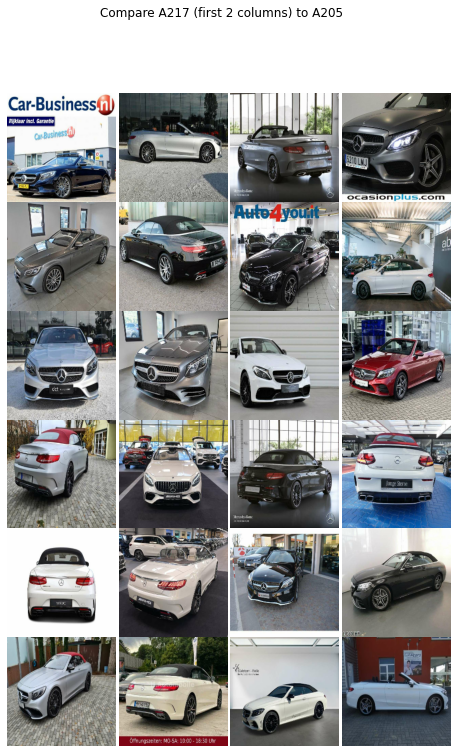

 target C117 predicted as X117 
get wrong images
show wrong images
22


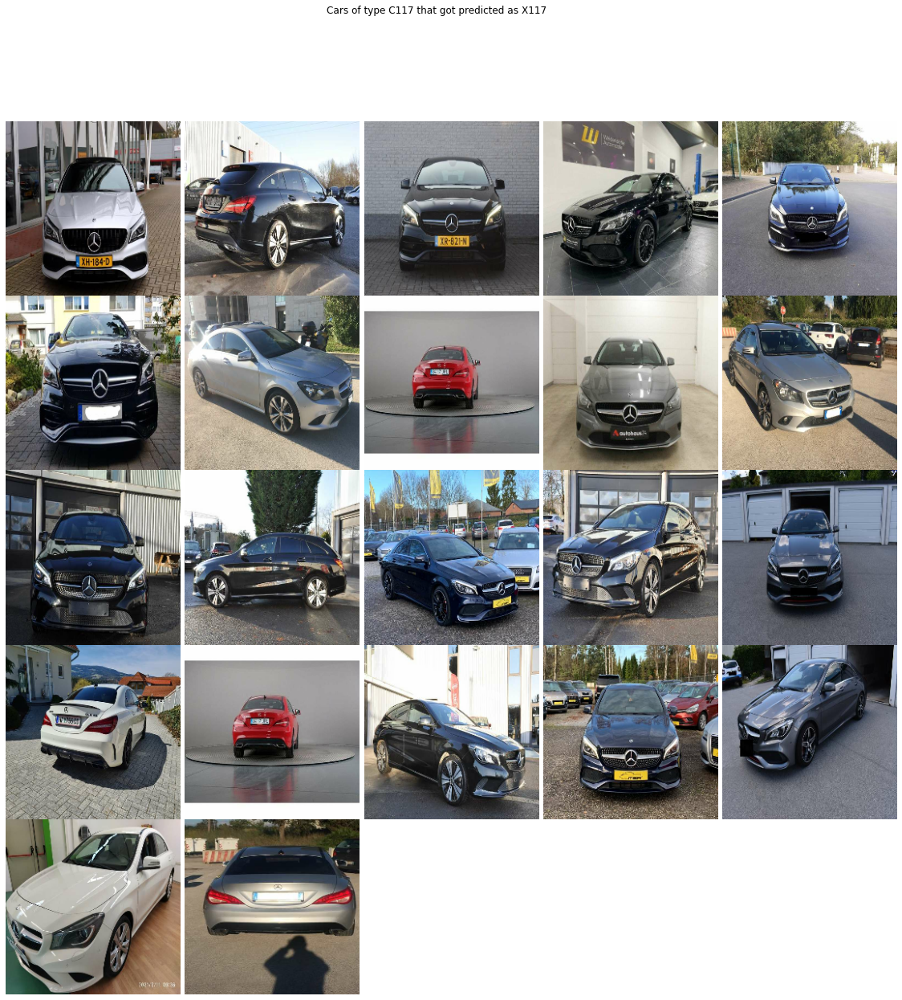

get examples to compare
show examples to compare


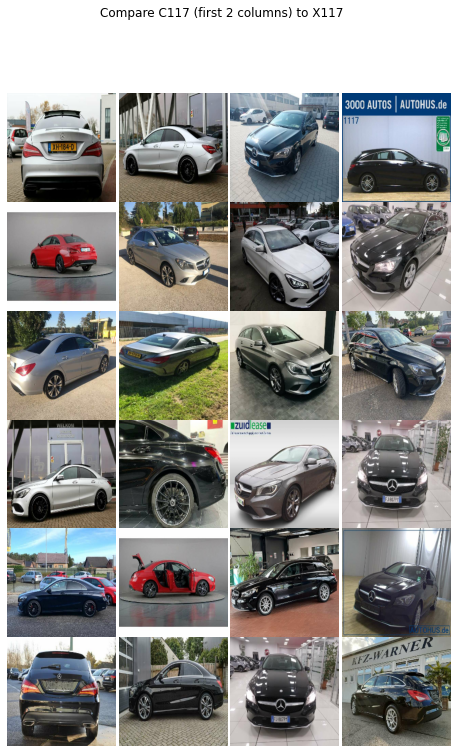

 target C118 predicted as X118 
get wrong images
show wrong images
27


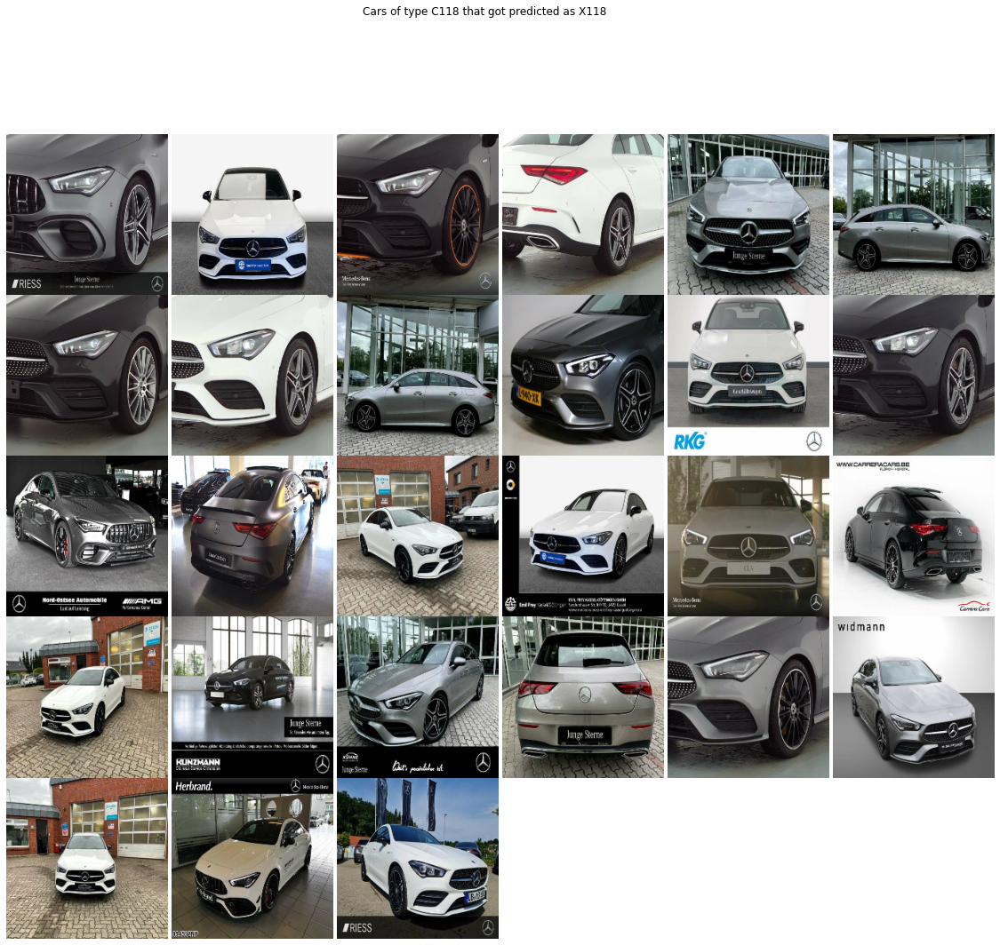

get examples to compare
show examples to compare


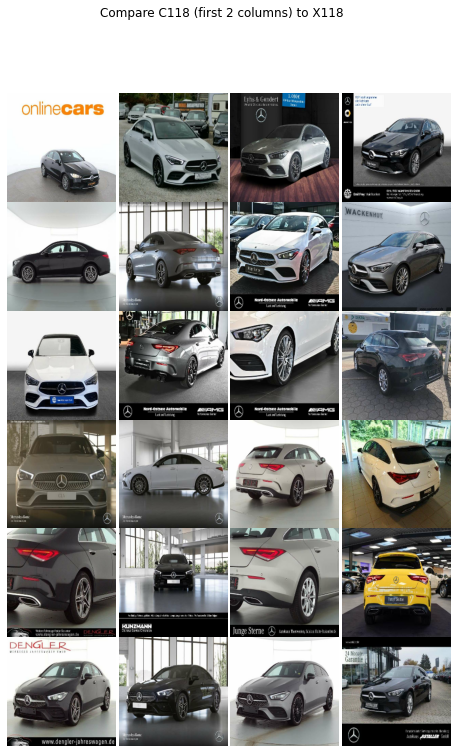

 target C204 predicted as W204 
get wrong images
show wrong images
24


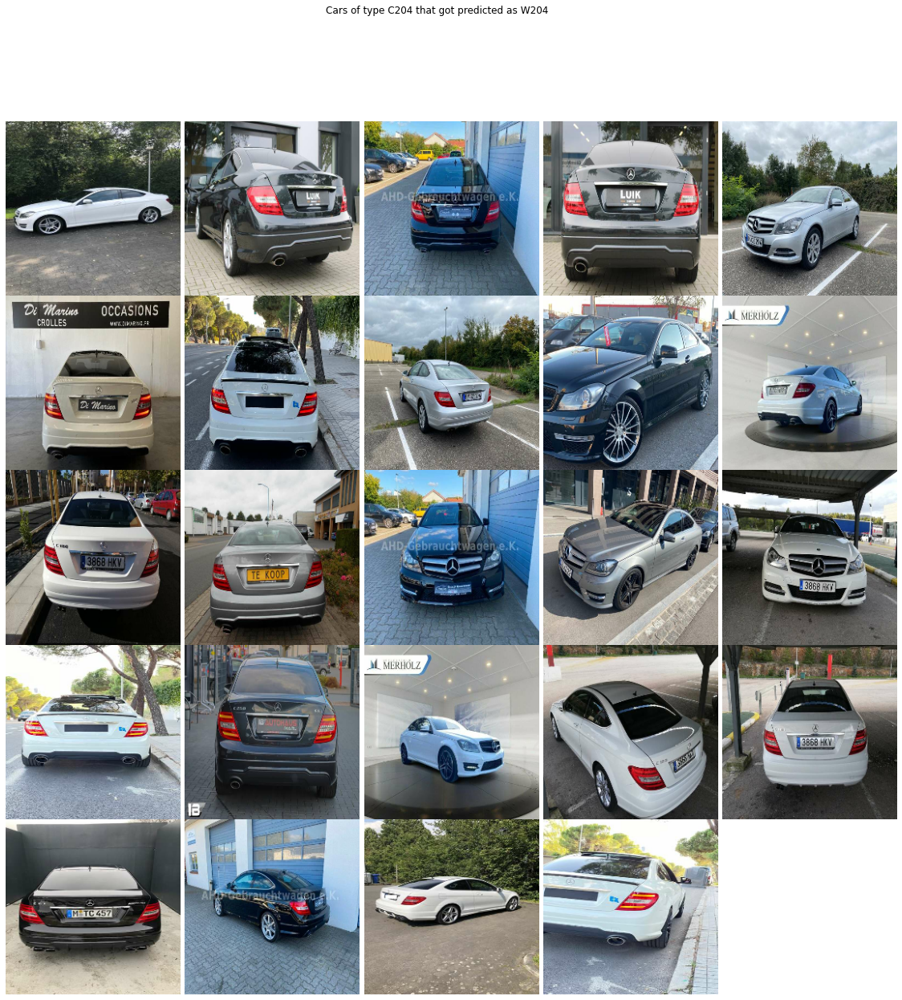

get examples to compare
show examples to compare


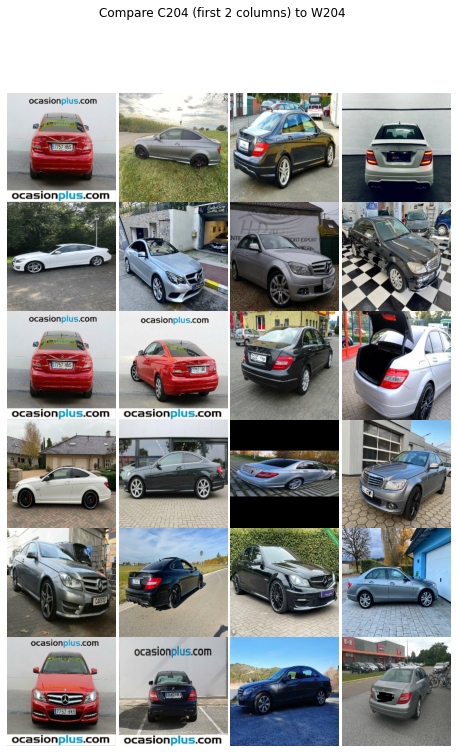

 target C208 predicted as A208 
get wrong images
show wrong images
18


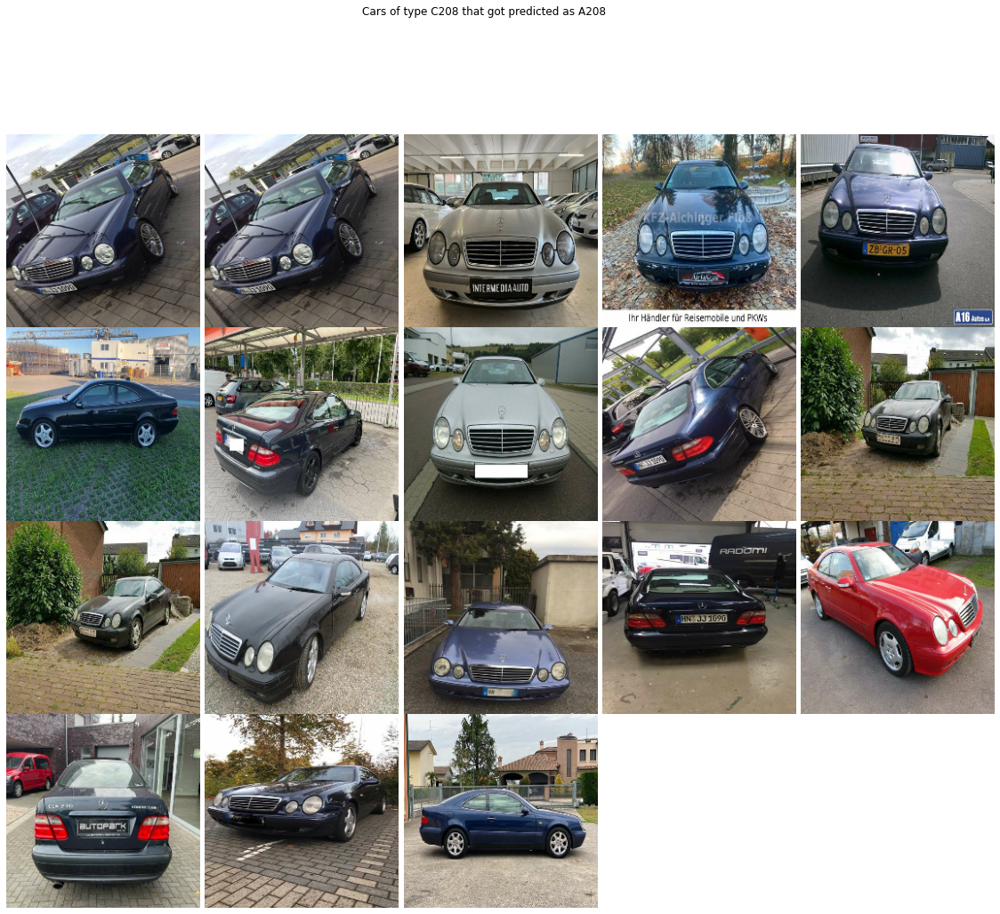

get examples to compare
show examples to compare


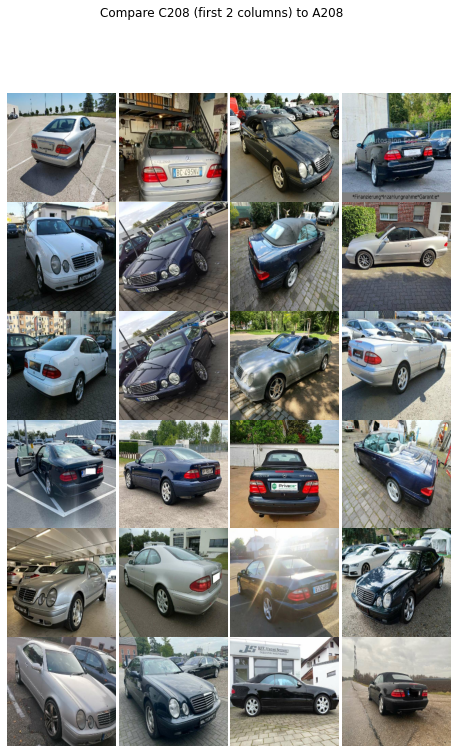

 target C209 predicted as A209 
get wrong images
show wrong images
34


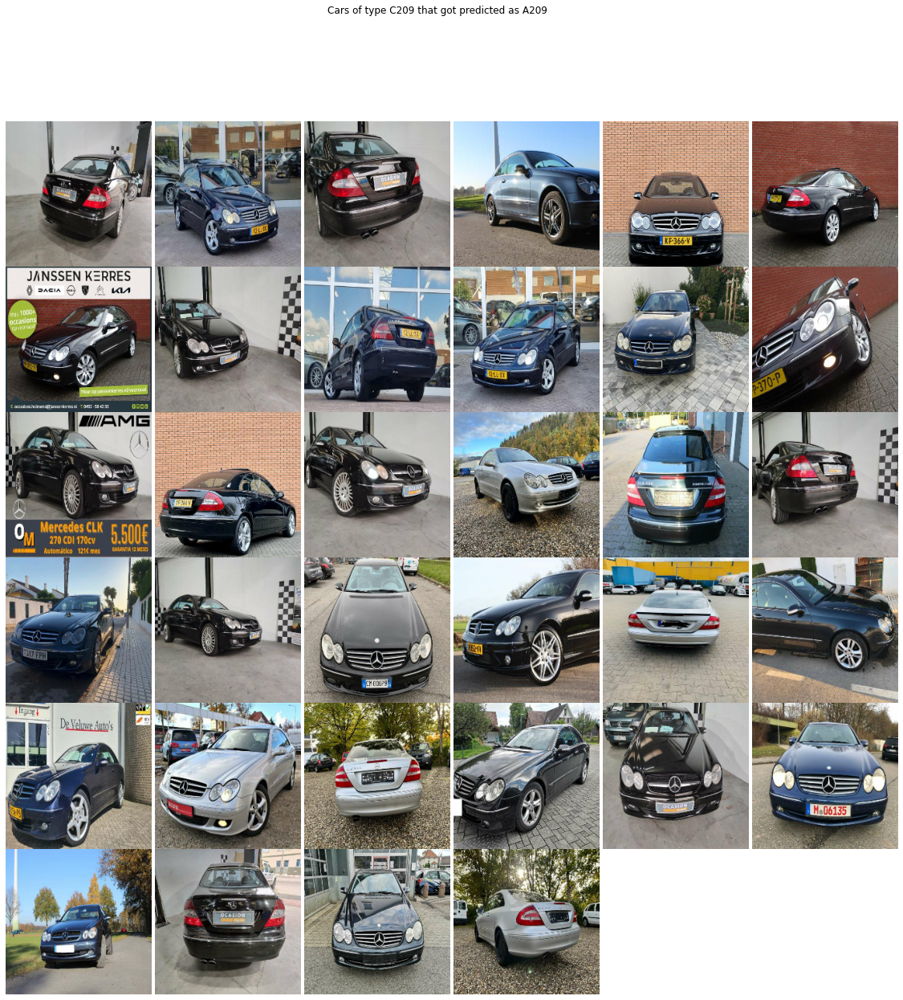

get examples to compare
show examples to compare


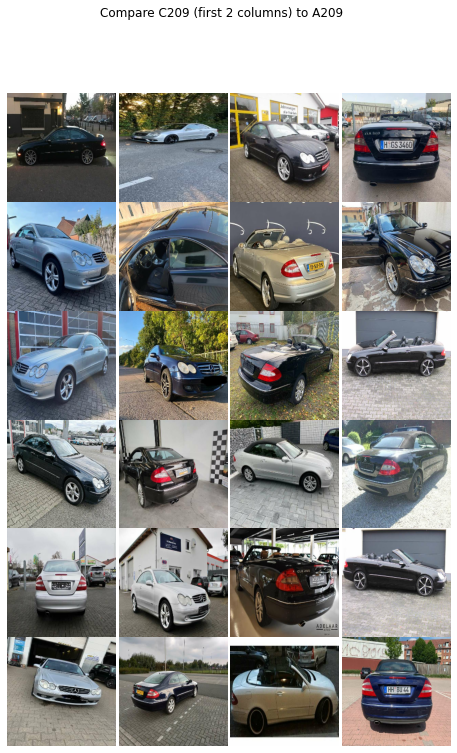

 target C238 predicted as A238 
get wrong images
show wrong images
64


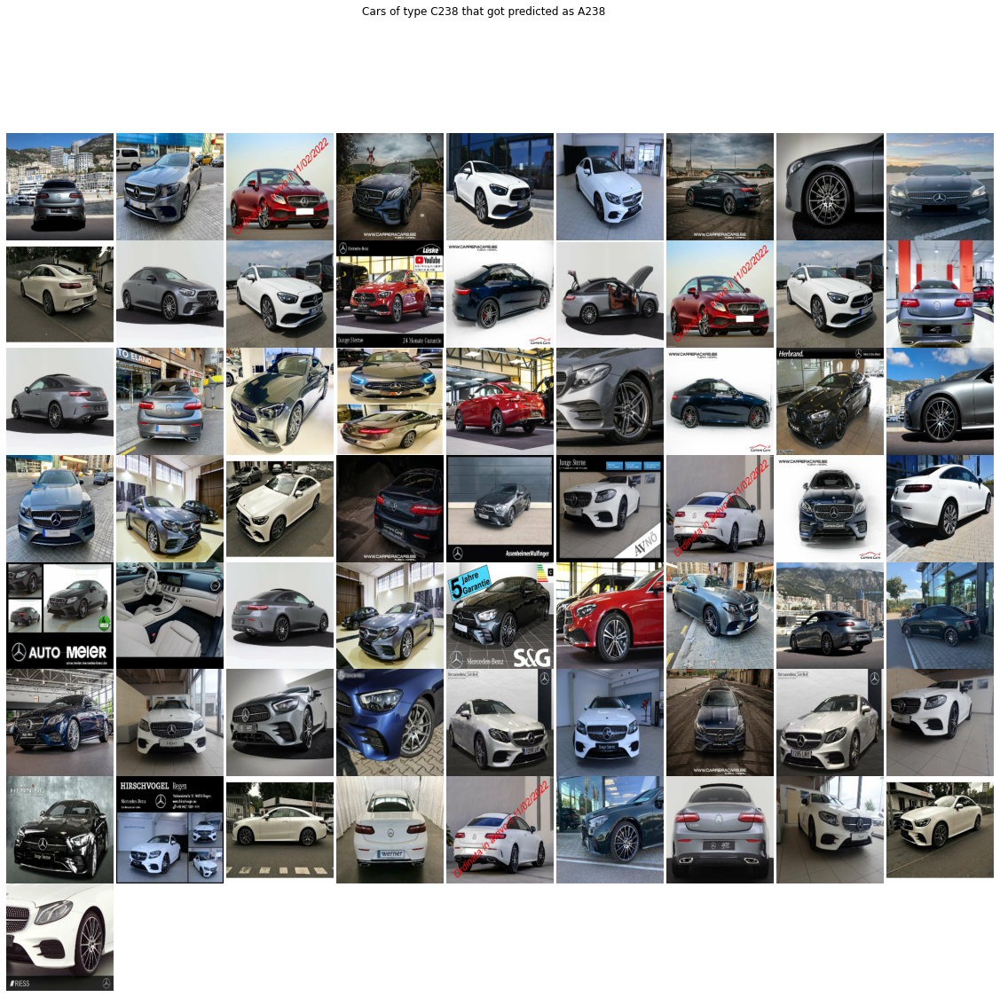

get examples to compare
show examples to compare


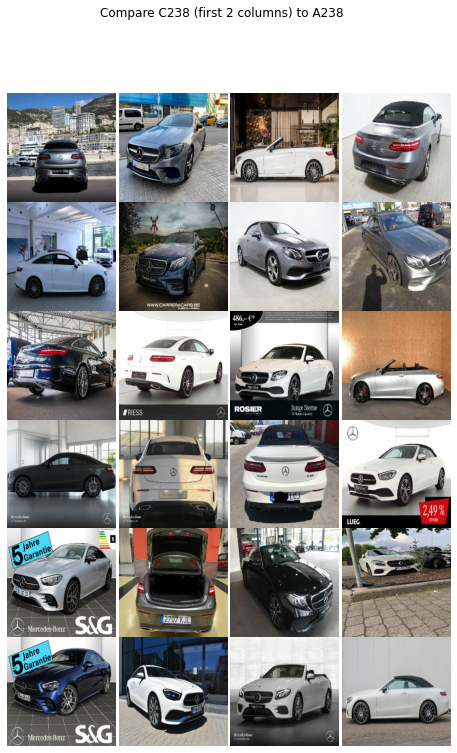

 target C253 predicted as X253 
get wrong images
show wrong images
27


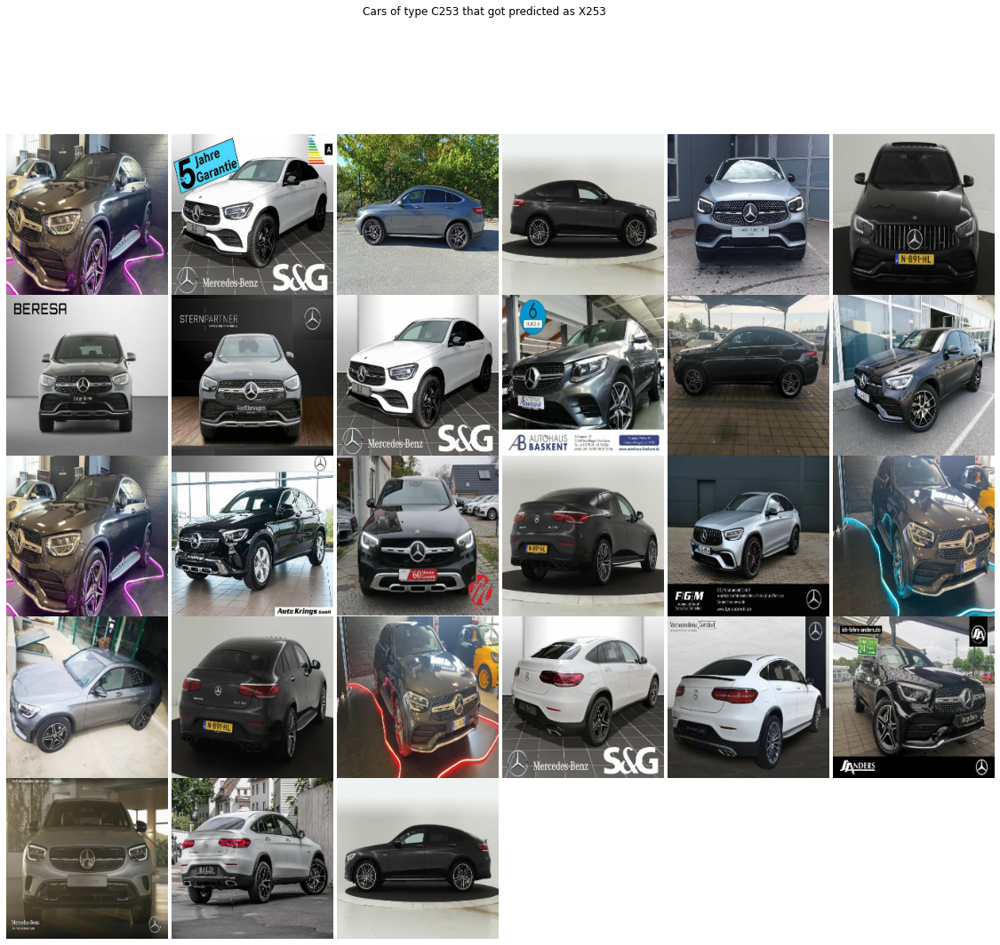

get examples to compare
show examples to compare


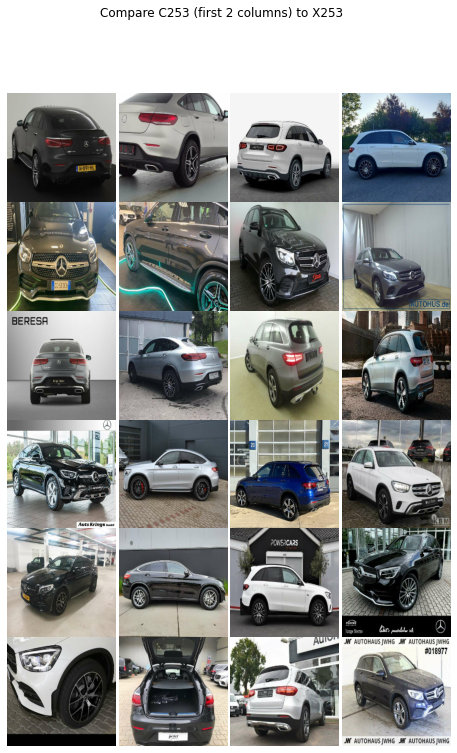

 target S202 predicted as W202 
get wrong images
show wrong images
11


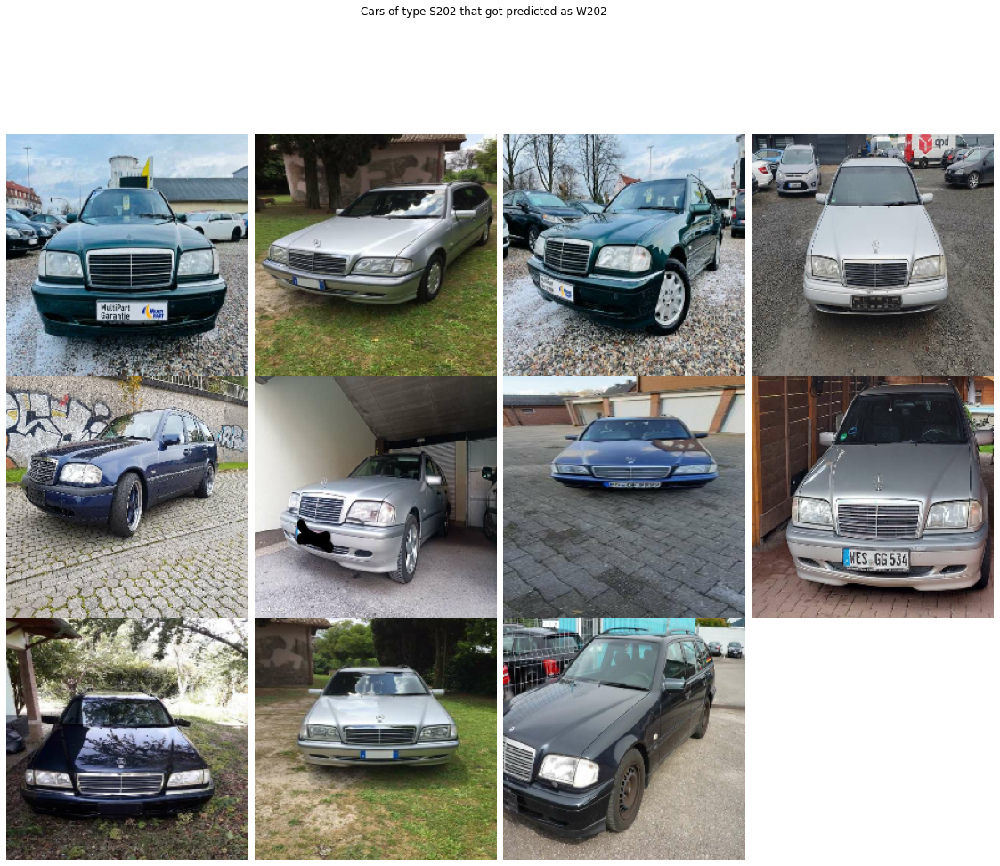

get examples to compare
show examples to compare


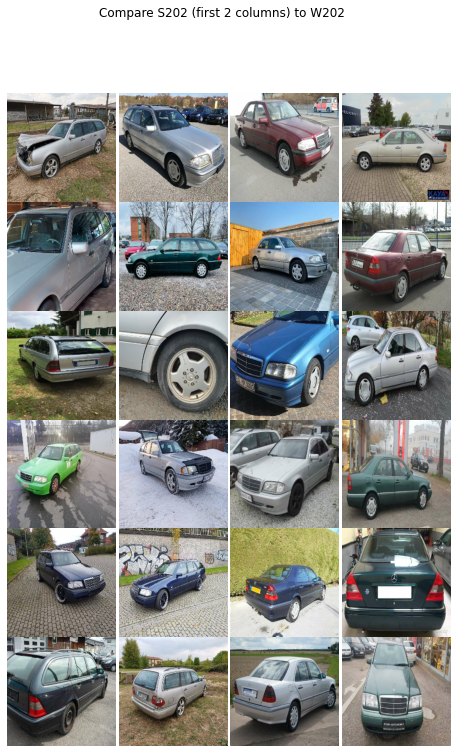

 target W166 predicted as C292 
get wrong images
show wrong images
32


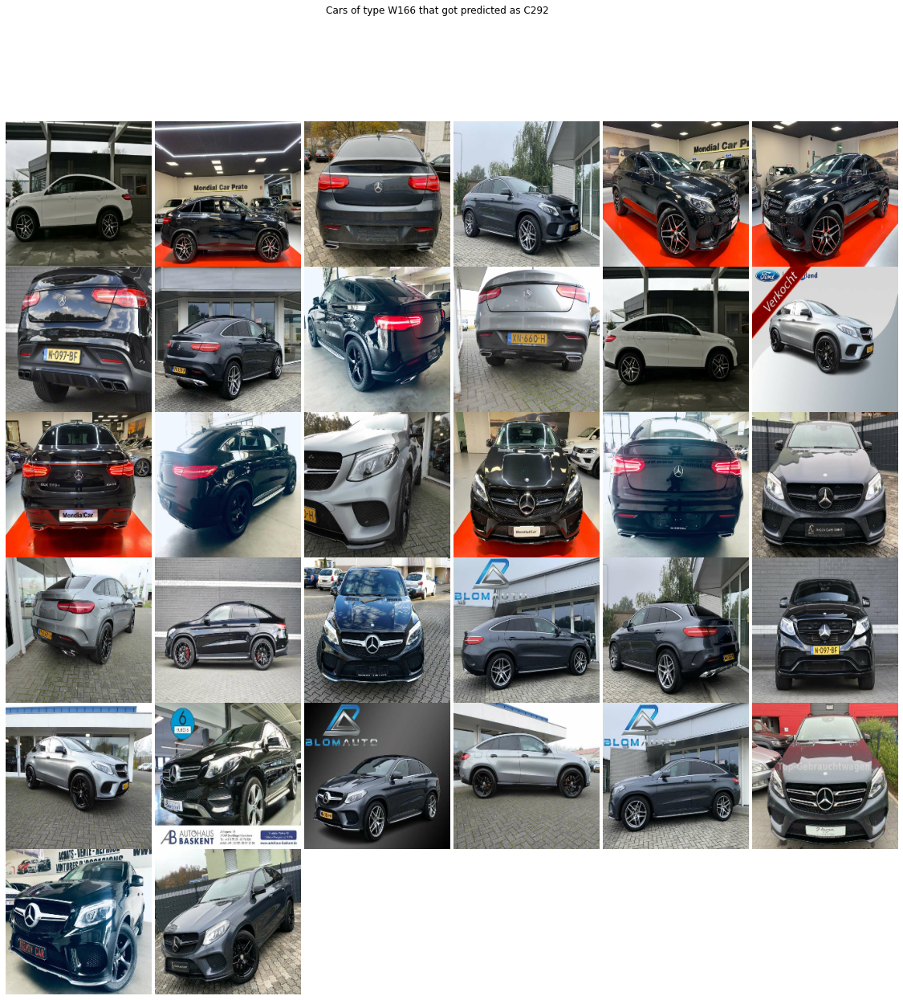

get examples to compare
show examples to compare


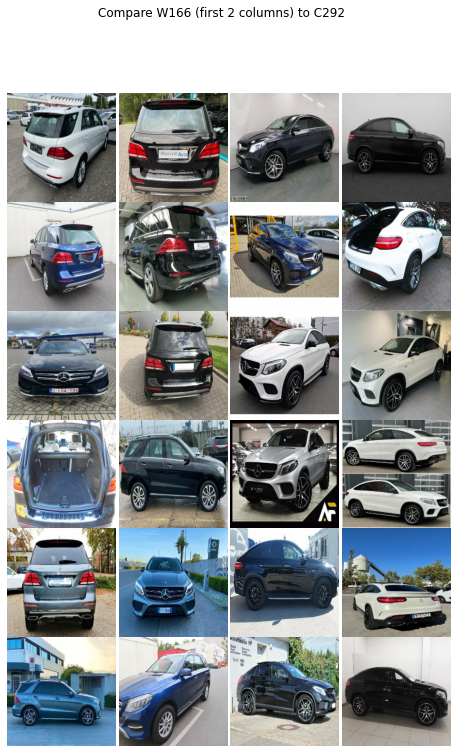

 target W205 predicted as S205 
get wrong images
show wrong images
116


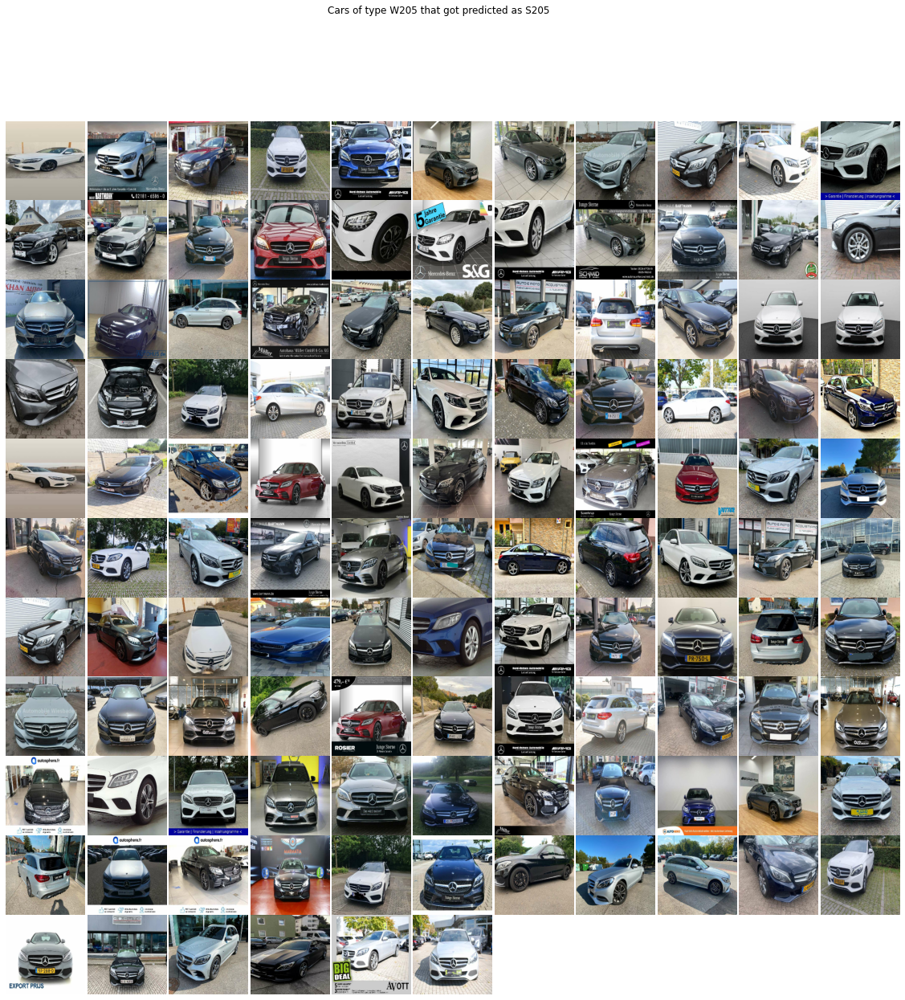

get examples to compare
show examples to compare


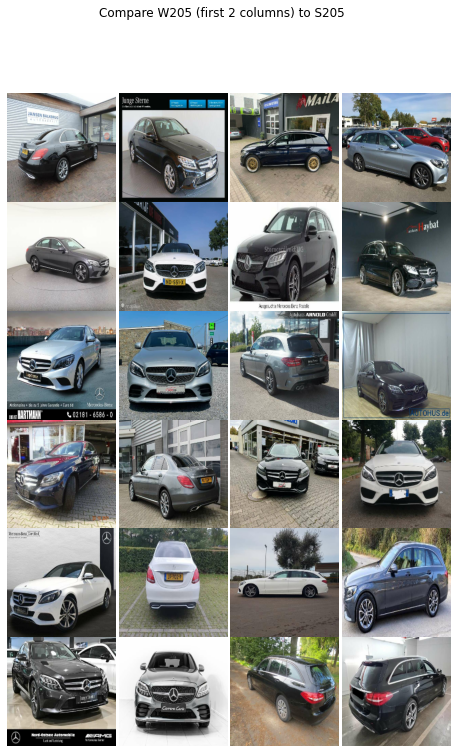

 target W213 predicted as S213 
get wrong images
show wrong images
105


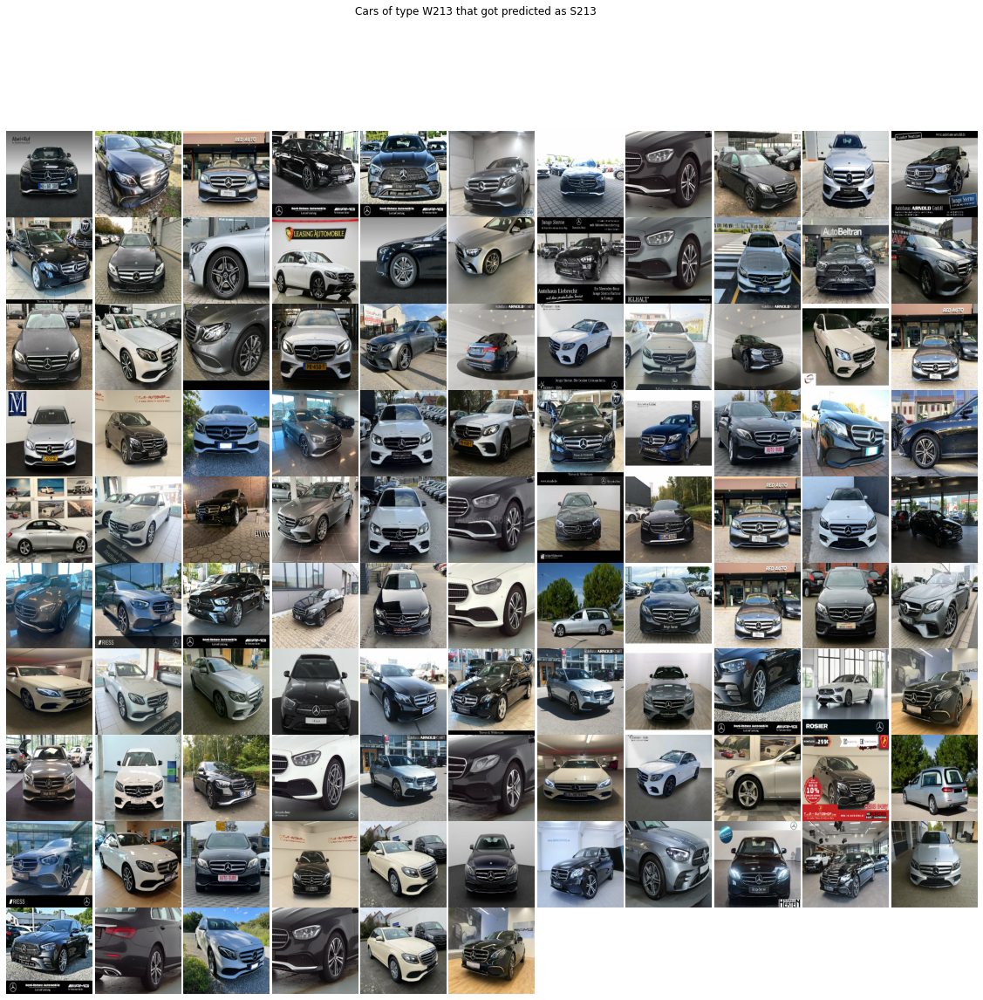

get examples to compare
show examples to compare


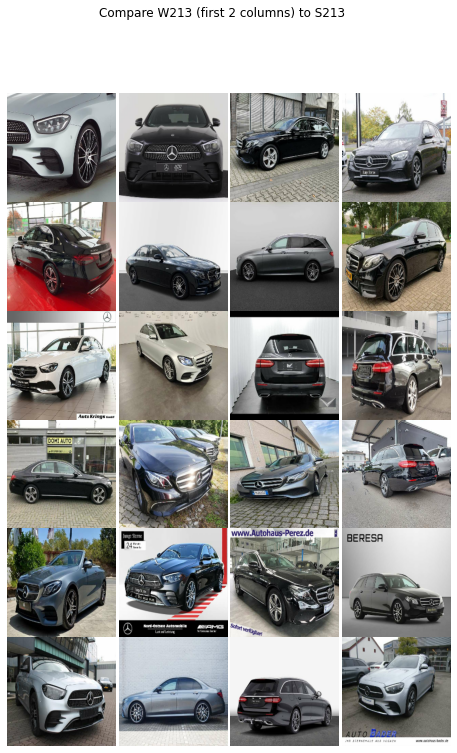

 target X218 predicted as C218 
get wrong images
show wrong images
42


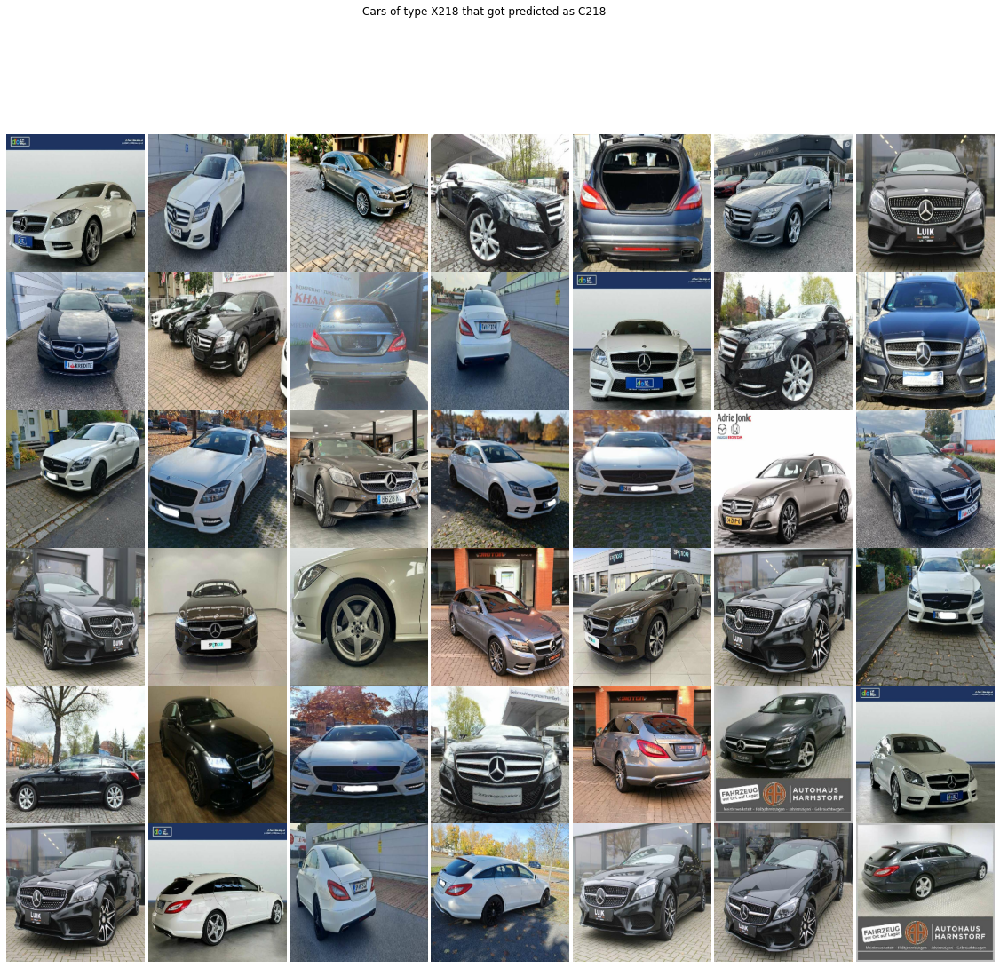

get examples to compare
show examples to compare


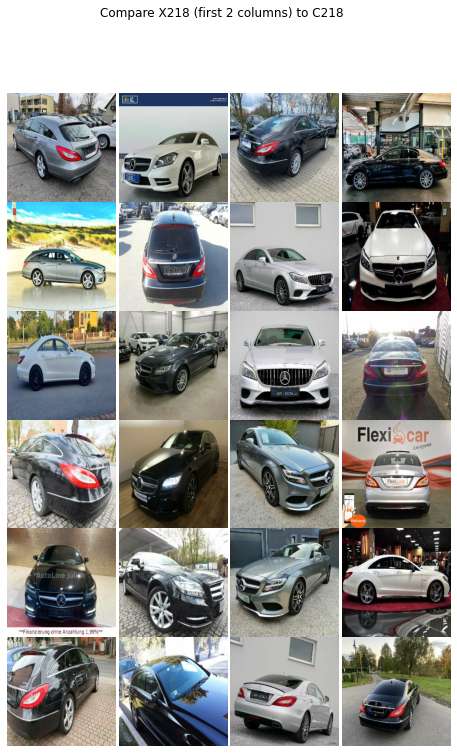

In [23]:
for target_class, v in highest_false_prediction_classes.items():
    if target_class in classes_to_have_closer_look:
        is_class = v[0]
        print(f" target {target_class} predicted as {is_class} ")
        
        #####
        # Get wrongly predicted images of those class types that are problematic
        wrong_images_all = []
        target_check = target_class 
        is_check = is_class 

        # iterates batch wise over validation dataset
        print("get wrong images")
        for images, targets in test_set:
            
            # is there a target image in this batch?
            continue_with_batch = False
            for n in range(0,len(targets)):
                if CLASS_NAMES[targets[n]] == target_check:
                    continue_with_batch = True
                    
            if continue_with_batch:    
                # y = model(image, training=False)  # Or y = model.predict(image)
                y = model.predict(images)
                #print("Batch")
                y = tf.nn.softmax(y)  # shape is (32, 65) 32 rows with 65 columns each column is one class
                # Get predicted label (max value index of each of the 32 rows)
                y = np.argmax(y, axis=1)
                targets = targets.numpy()

                for i in range(0,len(y)):
                    if y[i] != targets[i] and CLASS_NAMES[targets[i]] == target_check and CLASS_NAMES[y[i]] == is_check:
                        wrong_images_all.append(images[i])
        
        print("show wrong images")
        #####      
        # Plot wrongly predicted images
        images_to_show = wrong_images_all #[:30]
        print(len(images_to_show))
        cr = int(np.sqrt(len(images_to_show)))  # how many columns and rows the graph should have
        fig = plt.figure(figsize=(20,20)) 
        ax = [fig.add_subplot(cr+1,cr+1,i+1) for i in range(len(images_to_show))]
        n = 0
        for a in ax:
            a.set_xticklabels([])
            a.set_yticklabels([])
            #a.set_aspect('equal')
            a.axis("off")
            a.imshow(images_to_show[n].numpy()) 
            n += 1
        fig.subplots_adjust(wspace=0, hspace=0)
        plt.suptitle(f"Cars of type {target_check} that got predicted as {is_check}")
        plt.savefig(os.path.join(save_img_path,f'{target_check}_predicted_as_{is_check}.png'))
        plt.show()
        
        
        
        print("get examples to compare")
        #####
        # plot examples of both classes to compare
        cartype = target_class
        comparisontype = is_class
        cartype_images = []
        comparisontype_images = []

        # Get images of the searched class
        for im,l in test_set.take(1400):  #just a few batches
            # iterate over elements in batch
            for n in range(len(l)):
                if CLASS_NAMES[l[n]] == cartype:
                    cartype_images.append(im[n])
                if CLASS_NAMES[l[n]] == comparisontype:
                    comparisontype_images.append(im[n])
        
        print("show examples to compare")
        # plot the images of searched class in subplots left 2 columns target_class
        # last two columns is_class
        fig = plt.figure(figsize=(8,12)) # Notice the equal aspect ratio
        ax = [fig.add_subplot(6,4,n+1) for n in range(24)] # 24 images 6 per column, 4 columns
        i = 0
        count = 0
        for a in ax:
            a.axis("off")
            if count < 2: # the 2 left columns
                a.imshow(cartype_images[i].numpy())
                count += 1
            else:  # the right 2 columns
                a.imshow(comparisontype_images[i].numpy())
                count += 1
            if count == 4:
                count = 0
            i += 1
        fig.subplots_adjust(wspace=0, hspace=0)
        plt.suptitle(f"Compare {cartype} (first 2 columns) to {comparisontype}")
        plt.savefig(os.path.join(save_img_path,f'example_{cartype}_comared_to_{comparisontype}.png'))
        plt.show()

## Class Accuracy (highlightes issues)
Plot accuracy per class again but with highlighted classes of the worst performance. Red are the classes in which a single entry in the confusion matrix make up 10% or more of the errors.

The yellow classes are also underperforming (below 80% accuracy) but instead of a single dominant entry it is multiple entries in the confusion matrix.

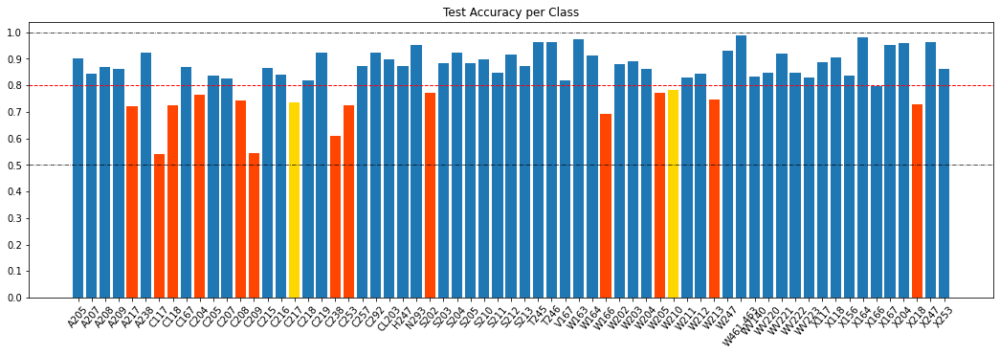

In [24]:
colors = []
for c in CLASS_NAMES:
    if c == "C217" or c == "W210":  # those two classes are below 80% accuracy.
        colors.append("gold")
    elif c in classes_to_have_closer_look:
        colors.append("orangered")
    else:
        colors.append("#1f77b4")  #default blue

fig = plt.figure(figsize=(7, 4))
ax = fig.add_axes([0, 0, 2, 1])
ax.bar(CLASS_NAMES, accuracy_per_class.values(), color=colors)
plt.xticks(rotation=50)
plt.yticks(np.arange(0.0, 1.1, 0.1))
plt.title("Test Accuracy per Class")
plt.axhline(y=0.5, color='black', linestyle='-.', lw=0.7)
plt.axhline(y=1.0, color='black', linestyle='-.', lw=0.7)
#plt.axhline(y=0.6, color='grey', linestyle='-.', lw=0.6)
#plt.axhline(y=0.7, color='grey', linestyle='-.', lw=0.6)
#plt.axhline(y=0.8, color='grey', linestyle='-.', lw=0.6)
#plt.axhline(y=0.9, color='grey', linestyle='-.', lw=0.6)
plt.axhline(y=0.8, color='red', linestyle='--', lw=1)
plt.savefig(os.path.join(save_img_path, 'accuracyPerClassHighlightedIssues.png'), bbox_inches="tight")
plt.show()

## Get wrong predicted images for specific classes
Same as above but now the classes are choosen manually, to investigate the yellow highlighted classes from the plot above.

In [25]:
target_class = "A217"
comparison = "A238"

In [26]:
wrong_images_all = []
# W166 als C292 sind 32 Fehler von 179 Dateien
# C209 Reihe auch viel probleme
#C238 als A238 sind 64 Fehler von 253

target_check = target_class #"W166"#"W205"  
is_check = comparison #"C292"#"S205"

#target_array = np.array([])
#prediction_array = np.array([])
#all_Images = np.array([])

print("START")
print(len(wrong_images_all))
# iterates batch wise over validation dataset
for images, targets in test_set:
    
    # is there a target image in this batch?
    continue_with_batch = False
    for n in range(0,len(targets)):
        if CLASS_NAMES[targets[n]] == target_check:
            continue_with_batch = True

    if continue_with_batch: 
        # y = model(image, training=False)  # Or y = model.predict(image)
        y = model.predict(images)
        #print("Batch")
        y = tf.nn.softmax(y)  # shape is (32, 65) 32 rows with 65 columns each column is one class
        # Get predicted label (max value index of each of the 32 rows)
        y = np.argmax(y, axis=1)
        #targets = targets.numpy()  #already numpy array

        for i in range(0,len(y)):
            if y[i] != targets[i] and CLASS_NAMES[targets[i]] == target_check and CLASS_NAMES[y[i]] == is_check:
                wrong_images_all.append(images[i])
            

print("all done")
    
    ##target_array = np.concatenate((target_array, targets))
    ##prediction_array = np.concatenate((prediction_array, y))

print(len(wrong_images_all))

START
0
all done
9


### show the images

9


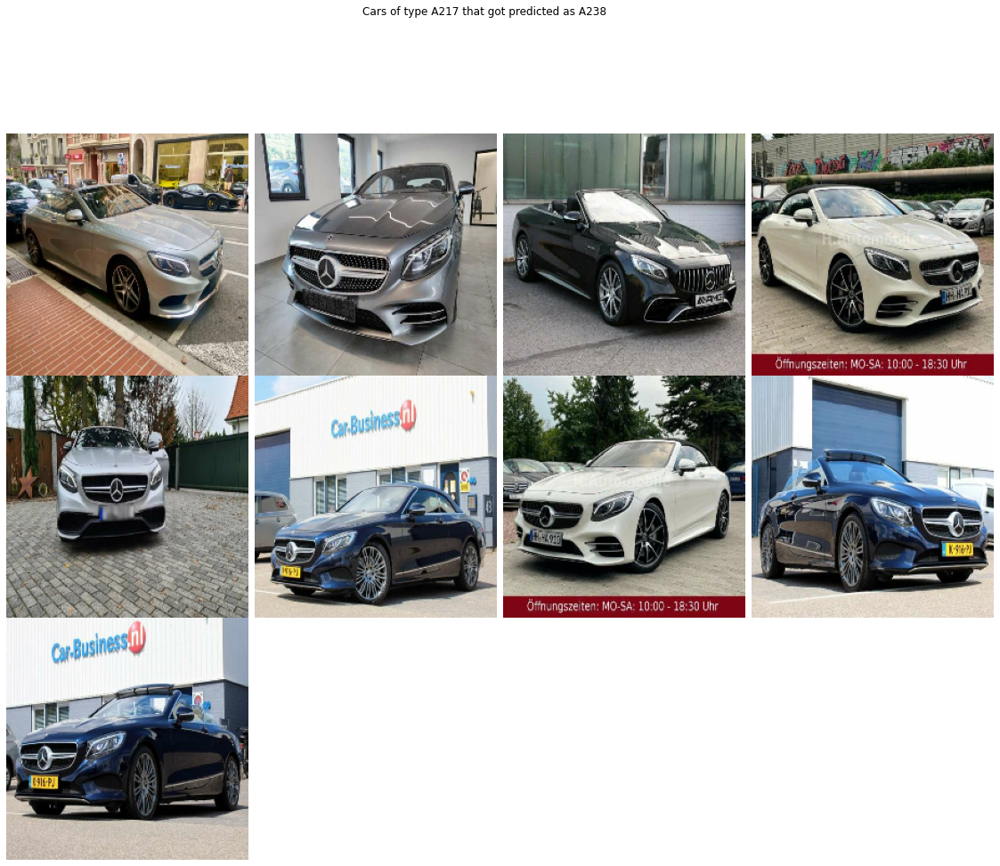

In [27]:
images_to_show = wrong_images_all #[:30]
print(len(images_to_show))

cr = int(np.sqrt(len(images_to_show)))  # how many columns and rows the graph should have
# W205 fälschlicherweise als S205 häufigstes Problem

fig = plt.figure(figsize=(20,20)) # Notice the equal aspect ratio
ax = [fig.add_subplot(cr+1,cr+1,n+1) for n in range(len(images_to_show))]
i = 0
for a in ax:
    a.set_xticklabels([])
    a.set_yticklabels([])
    #a.set_aspect('equal')
    a.axis("off")
    a.imshow(images_to_show[i].numpy()) 
    i += 1
fig.subplots_adjust(wspace=0, hspace=0)
plt.suptitle(f"Cars of type {target_check} that got predicted as {is_check}")
plt.savefig(os.path.join(save_img_path,f'{target_check}_predicted_as_{is_check}.png'))
plt.show()

## Get some examples for given class to compare cars

67
353


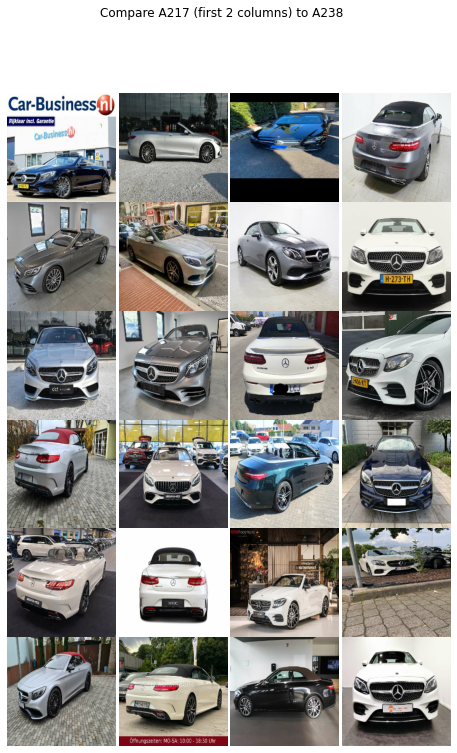

In [28]:
cartype = target_class #"C217" #"W205"#"C209"
comparisontype = comparison #"A217"#"S205"#"A209"
cartype_images = []
comparisontype_images = []

# Get images of the searched class
for im,l in test_set.take(1400):  
    # iterate over elements in batch
    for n in range(len(l)):
        if CLASS_NAMES[l[n]] == cartype:
            cartype_images.append(im[n])
        if CLASS_NAMES[l[n]] == comparisontype:
            comparisontype_images.append(im[n])
            
print(len(cartype_images))
print(len(comparisontype_images))
#plot the images of searched class in subplots with 10 columns. 10 Images of each class per column.
fig = plt.figure(figsize=(8,12)) # Notice the equal aspect ratio
ax = [fig.add_subplot(6,4,i+1) for i in range(24)]
i = 0
count = 0
for a in ax:
    a.axis("off")
    if count < 2: # the 2 left columns
        a.imshow(cartype_images[i].numpy())
        count += 1
    else:  # the right 2 columns
        a.imshow(comparisontype_images[i].numpy())
        count += 1
    if count == 4:
        count = 0
        
    i += 1
fig.subplots_adjust(wspace=0, hspace=0)
plt.suptitle(f"Compare {cartype} (first 2 columns) to {comparisontype}")
plt.savefig(os.path.join(save_img_path,f'example_{cartype}_comared_to_{comparisontype}.png'))
plt.show()

----